<a href="https://colab.research.google.com/github/86lekwenshiung/Tensorflow-Dog-Breed-Identification/blob/main/dog_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**# Problem Definiton**

# End-to-End Multi-class Dog Breed Classification

This notebook builds an end-toend multi-class image clasifier using TensorFlow 2.0 and Tensorflow Hub

## 1. Problem
Identifying the breeed of a dog given an image of a dog.

## 2. Data
The data we are using is from Kaggle's dog breed indeitifcation competition.
https://www.kaggle.com/c/dog-breed-identification/data

## 3. Evaluation
Multi Class Log Loss between predicted proability and observed target

## 4. Features
* Unstructured Data
* More than 120 classification 
* More than 10,000 images in training set
(Have labels)
* More than 10,000 images in test_set
(No Labels because we want to predict them)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Unzip folder
#!unzip '/content/drive/MyDrive/Colab_Notebooks/dog_vision/tensorflow_data.zip' -d '/content/drive/MyDrive/Colab_Notebooks/dog_vision' 

## **Tool Import**

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
print('TF Version :' , tf.__version__)
print('TFhub_version :' , hub.__version__)
print('GPU is available' if tf.config.list_physical_devices('GPU') else 'Not Avaliable')

TF Version : 2.4.1
TFhub_version : 0.12.0
GPU is available


## **Libraries Import**

In [ ]:
# Libraries Import

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import imread
from IPython.display import Image
from sklearn.model_selection import train_test_split
import os

In [ ]:
label_df = pd.read_csv('/content/drive/MyDrive/Colab_Notebooks/dog_vision/labels.csv')
label_df.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


## **Import CSV / Explore Datasets**

In [ ]:
label_df.breed.value_counts()

scottish_deerhound      126
maltese_dog             117
afghan_hound            116
entlebucher             115
bernese_mountain_dog    114
                       ... 
komondor                 67
brabancon_griffon        67
golden_retriever         67
eskimo_dog               66
briard                   66
Name: breed, Length: 120, dtype: int64

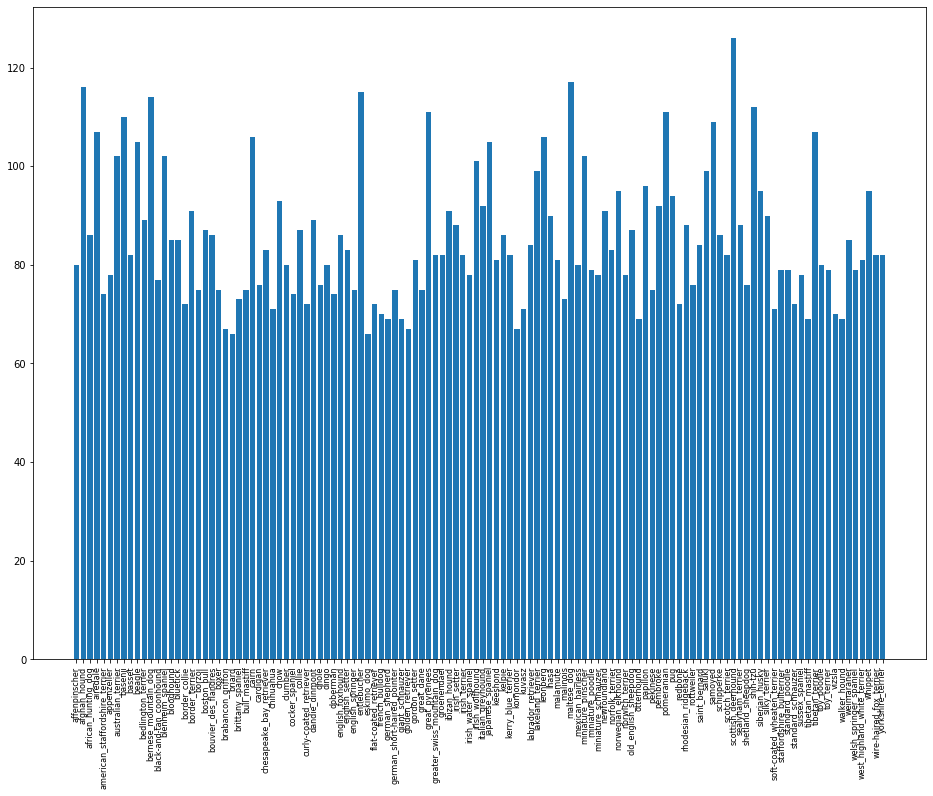

In [ ]:
breed_df = label_df.groupby('breed' , as_index=False).count()
breed_df.columns = ['Breed' , 'Count']
breed_df
plt.figure(figsize = (16,12))
plt.bar(x = 'Breed',
        height = 'Count',
        data = breed_df)
plt.xticks(rotation = 90 , fontsize = 8)
plt.show()

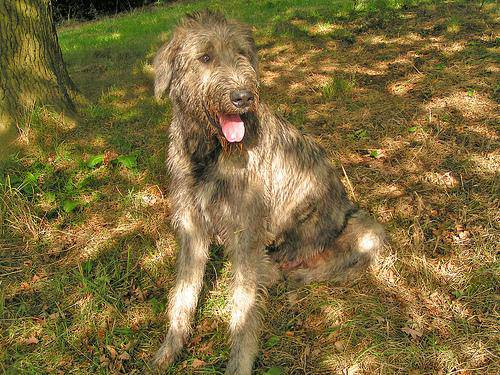

In [ ]:
Image('/content/drive/MyDrive/Colab_Notebooks/dog_vision/test_data/000621fb3cbb32d8935728e48679680e.jpg')
Image('/content/drive/MyDrive/Colab_Notebooks/dog_vision/test_data/002f80396f1e3db687c5932d7978b196.jpg')

In [ ]:
label_df
# Image('/content/drive/MyDrive/Colab_Notebooks/dog_vision/test_data/002f80396f1e3db687c5932d7978b196.jpg')

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever
...,...,...
10217,ffd25009d635cfd16e793503ac5edef0,borzoi
10218,ffd3f636f7f379c51ba3648a9ff8254f,dandie_dinmont
10219,ffe2ca6c940cddfee68fa3cc6c63213f,airedale
10220,ffe5f6d8e2bff356e9482a80a6e29aac,miniature_pinscher


## **Processing Data**

### Create image filepath on photo id directory (Features)

In [ ]:
# filename = []
# for fname in label_df.id:
#    filename.append('/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/'+fname+'.jpg')
# filename[0:10]

filename = ['/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/'+fname+'.jpg' for fname in label_df.id]
filename[0:10]

['/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/0042188c895a2f14ef6

In [ ]:
os.listdir('/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data')[:10]

['e7f4f3c25291884f2dfe7c60051d6949.jpg',
 'e7f6ec634384c07f7a0f5659e4f77867.jpg',
 'e7ab11f849e895ced3cdddf4d90e5bd2.jpg',
 'e8013a8357f9eec2369ee4e3fab710a1.jpg',
 'e7f2f67cb616281a89fc77a6bdea6eb0.jpg',
 'e7faa5748d8320f604aeb3fd5bbe4ab0.jpg',
 'e79f822b26adace4455db1fcd94ab47e.jpg',
 'e7f3274adaad369068602a422e9df192.jpg',
 'e8057e2f1e3bca4e9f4a2af48a9a9c46.jpg',
 'e7af8f590b4fbdca0779f5e606ef91a1.jpg']

In [ ]:
if len(os.listdir('/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data')) == len(filename):
  print('Filename quantity match amount of files')
else:
  print('Filename quantity do not match amount of files')

Filename quantity match amount of files


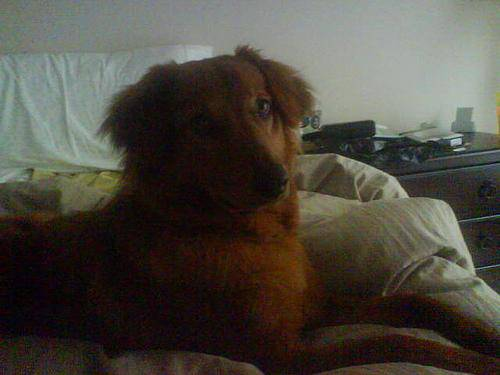

In [ ]:
Image(filename[1000])

In [ ]:
label_df.breed[1000]

'irish_setter'

### Create labels and converting them to True / False (Predicted Value / Results Truth)

In [ ]:
labels = np.array(label_df.breed)
len(labels)

10222

In [ ]:
# label_df.breed.value_counts()
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [ ]:
print(labels[0])
print(unique_breeds[19])
labels[0] == unique_breeds

boston_bull
boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# bool_labels = []
# for label in labels:
#   bool_labels.append(label == unique_breeds)

# bool_labels[:2] , len(bool_labels)

bool_labels = [label == unique_breeds for label in labels]
bool_labels[0:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
print(labels[0]) # breed of dog from original df
print(np.where((unique_breeds) == labels[0])) # Check position on unique_breed array where it matches with breed of dog from labels
print(bool_labels[0].argmax()) # Check the 'nth' array in bool_labels and check where maximum value occur (true = 1 , false  = 0)
print(bool_labels[0].astype(int)) # Converting True / False into 1 & 0

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Creating Validation Set

In [ ]:
# Set up X and y variables
X = filename
y = bool_labels

len(filename) , len(bool_labels)

(10222, 10222)

### Varying images number for **train_test_split**

In [ ]:
NUM_IMAGES = 1000 #@param{type : 'slider' , min :1000 , max : 10000}

In [ ]:
from sklearn.model_selection import train_test_split
X_train = X[:NUM_IMAGES]
y_train = y[:NUM_IMAGES]
X_train , X_val , y_train , y_val = train_test_split(X_train, y_train,
                                                     test_size = 0.2,
                                                     random_state = 42)

In [ ]:
len(X_train) , len(y_train), len(X_val) , len(y_val)

(800, 800, 200, 200)

In [ ]:
X_train[:2] , y_train[:2]

(['/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/00bee065dcec471f26394855c5c2f3de.jpg',
  '/content/drive/MyDrive/Colab_Notebooks/dog_vision/train_data/0d2f9e12a2611d911d91a339074c8154.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
 

## **Processing Images (Turning Images into Tensors)**

1.   Load Data (From the filepath)
2.   User *tensorflow* to read the rile and save it to variable `image` `via io.read_file`
3.   Turn `image`(jpg) into tensors via`decode_jpeg`
4.   Normalise image into 0 and 1 via `convert_image_dtype`
5.   Resize `image` to shape (224 , 224)
6.   Return modified `image`









In [ ]:
from matplotlib.pyplot import imread
image  = imread(filename[110])
print(image[:2])
print(image.max() , image.min()) # base on color pixel - Max is 255 , Min is 0

[[[ 58  60  73]
  [115 119 131]
  [202 208 222]
  ...
  [172 154 152]
  [172 154 152]
  [172 154 152]]

 [[ 76  78  91]
  [ 63  67  79]
  [ 39  45  59]
  ...
  [173 155 153]
  [173 155 153]
  [173 155 153]]]
255 0


In [ ]:
tf.constant(image)[:10]

<tf.Tensor: shape=(10, 500, 3), dtype=uint8, numpy=
array([[[ 58,  60,  73],
        [115, 119, 131],
        [202, 208, 222],
        ...,
        [172, 154, 152],
        [172, 154, 152],
        [172, 154, 152]],

       [[ 76,  78,  91],
        [ 63,  67,  79],
        [ 39,  45,  59],
        ...,
        [173, 155, 153],
        [173, 155, 153],
        [173, 155, 153]],

       [[ 92,  94, 107],
        [ 86,  90, 102],
        [ 92,  98, 110],
        ...,
        [173, 155, 153],
        [173, 155, 153],
        [173, 155, 153]],

       ...,

       [[ 85,  87,  99],
        [ 84,  88,  99],
        [ 85,  89, 101],
        ...,
        [175, 157, 157],
        [175, 157, 157],
        [175, 157, 157]],

       [[ 86,  88, 100],
        [ 86,  88, 100],
        [ 85,  89, 100],
        ...,
        [172, 153, 155],
        [172, 153, 155],
        [172, 153, 155]],

       [[ 82,  84,  96],
        [ 82,  84,  96],
        [ 82,  84,  96],
        ...,
        [172, 153, 155

### Write a short function that converts a file path to an (img, label) pair:

In [ ]:
# Sample Output from tensor
# tensor = tf.io.read_file(filename[1])
# tensor = tf.image.decode_jpeg(tensor , channels=3)
# tensor = tf.image.convert_image_dtype(tensor, tf.float32)
# tensor

In [ ]:
size = [224,224]
def process_image(file_path):
  img = tf.io.read_file(file_path) # load raw data as a string
  img = tf.image.decode_jpeg(img , channels =3) # convert compressed string to a 3D tensor
  img = tf.image.convert_image_dtype(img , tf.float32) # Convert coloir channel from 255 - 0 to 1 - 0 values
  img = tf.image.resize(img , size) # Resize the image into shape

  return img

### Turning Data into Batches

If we try to fit and process alot of photos, for example >10,000 images, they might not fit into the memory. 

Optimal way is to do by batches of 32 at a time.

In order to use tensorflow effectively, we need our data in the form of Tensor Tuples which look like (`image , label`)

In [ ]:

def get_image_label(file_path , label):
  img = process_image(file_path)

  return img , label

In [ ]:
# (process_image(X[42]) , tf.constant(y[42]))

In [ ]:
BATCH_SIZE = 32

def create_data_batches(X , y=None , batch_size = BATCH_SIZE , valid_data = False , test_data = False):
  """
  Create batches of data out of image (X) and label (y) pairs
  Will shuffle data if it is training data
  Will not shuffle data if it is validation data
  Also accept test data as input (test_data has no label) 
  """
  # If input is a test dataset , will not have labels
  if test_data:
    print('Creating test data batches.. ')
    data = tf.data.Dataset.from_tensor_slices(tf.constant(X)) #only filepath. (1) Create a source dataset from input (2)Apply dataset transformation (3)Iterrate over dataset and process element
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  # If input is a validation dataset , will not shuffle data
  elif valid_data:
    print('Creating Validation data batches..')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                              tf.constant(y)))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch
  # If input is a training dataset, will shuffle data
  else:
    print('Creating Training data batches...')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                              tf.constant(y)))
    data = data.shuffle(buffer_size = len(X))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

In [ ]:
train_data = create_data_batches(X_train , y_train)
val_data = create_data_batches(X_val , y_val , valid_data = True)

Creating Training data batches...
Creating Validation data batches..


In [ ]:
train_data.element_spec , val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

In [ ]:
train_data # (1st array refer to img , 2nd array refer to label)

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
train_images , train_labels = next(iter(train_data))
train_images , train_labels

(<tf.Tensor: shape=(32, 224, 224, 3), dtype=float32, numpy=
 array([[[[0.46726194, 0.7143207 , 0.3966737 ],
          [0.46262562, 0.70968443, 0.3920374 ],
          [0.45443806, 0.7014969 , 0.38384983],
          ...,
          [0.5383466 , 0.7261355 , 0.5396858 ],
          [0.58153284, 0.7624415 , 0.6137278 ],
          [0.5781229 , 0.7560728 , 0.6240984 ]],
 
         [[0.43582508, 0.68288386, 0.36523682],
          [0.4330799 , 0.6801387 , 0.36249164],
          [0.43256307, 0.6796219 , 0.3619748 ],
          ...,
          [0.55812085, 0.7498313 , 0.56774956],
          [0.5764709 , 0.76470625, 0.6068104 ],
          [0.55235505, 0.73666877, 0.6003768 ]],
 
         [[0.43367842, 0.6804221 , 0.37124842],
          [0.43675599, 0.6834997 , 0.37432602],
          [0.44044036, 0.68718404, 0.3780104 ],
          ...,
          [0.550752  , 0.755268  , 0.5676462 ],
          [0.5191399 , 0.7202452 , 0.55551016],
          [0.45322758, 0.6516118 , 0.4970126 ]],
 
         ...,
 
      

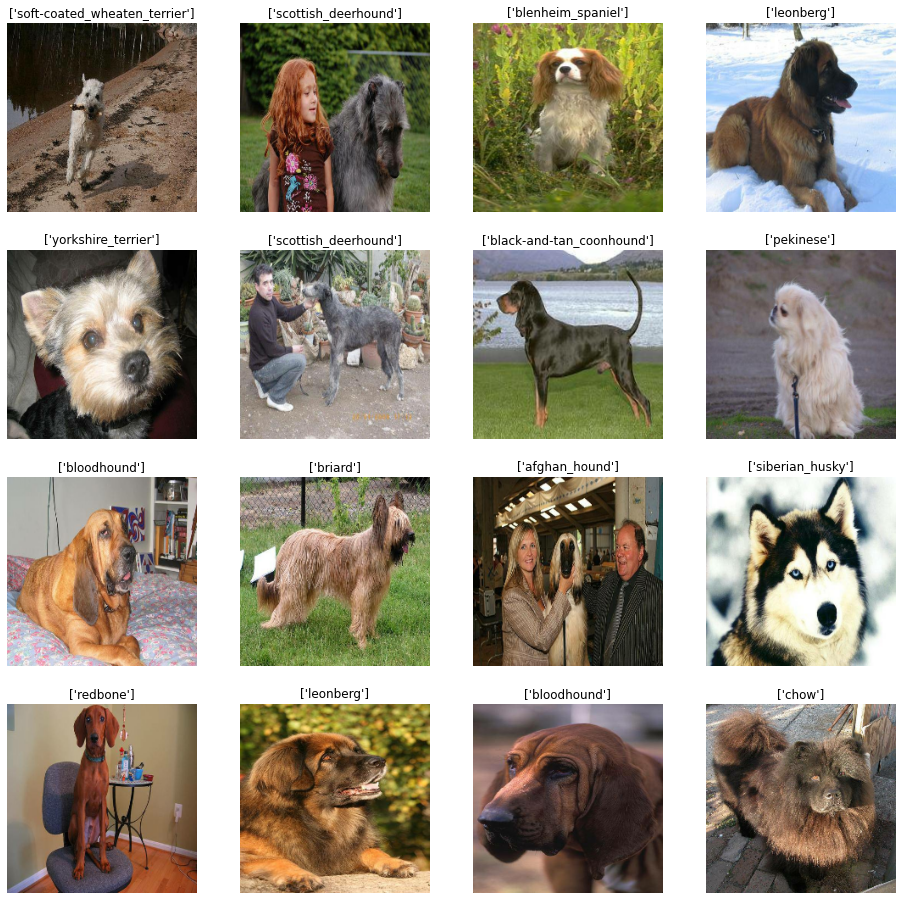

In [ ]:
# Visualising Data for Training Dataset
# https://www.tensorflow.org/tutorials/load_data/images

train_images , train_labels = next(iter(train_data))
plt.figure(figsize = (16,16))
for i in range(16):
  ax = plt.subplot(4,4 , i+1)
  plt.imshow(train_images[i])

  label = train_labels[i]
  plt.title(unique_breeds[label])
  plt.axis('off')

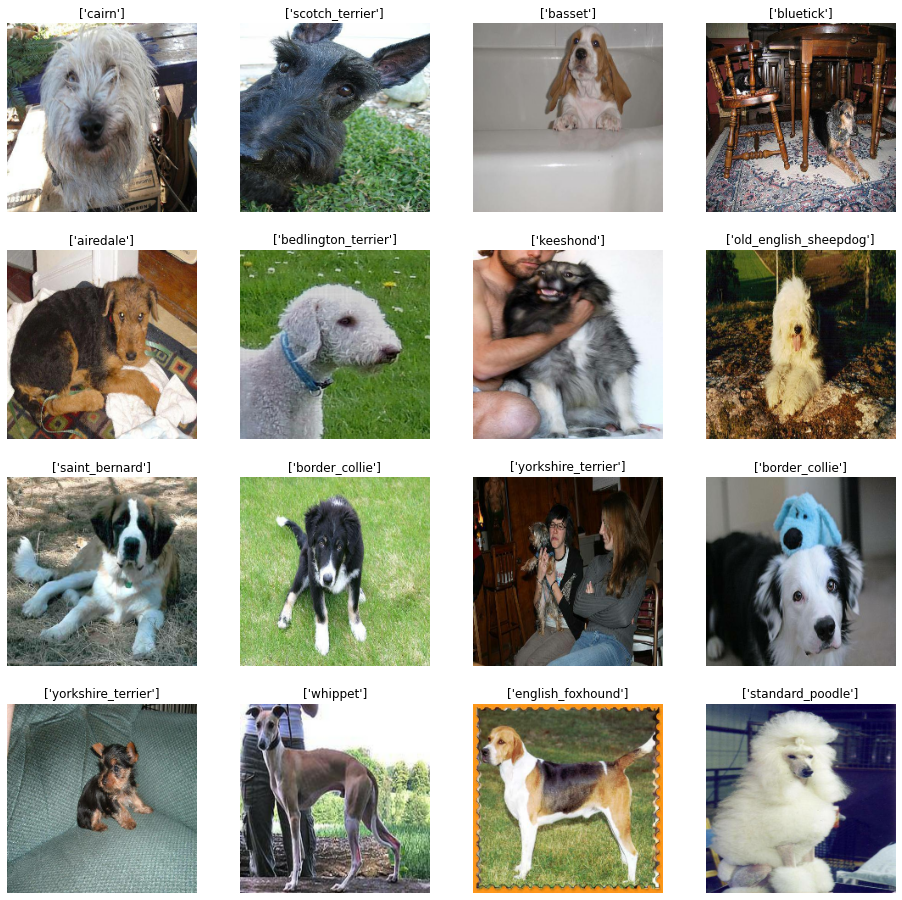

In [ ]:
# Visualising Data for Validation Dataset
# https://www.tensorflow.org/tutorials/load_data/images

val_images , val_labels = next(iter(val_data))

plt.figure(figsize = (16,16))
for i in range(16):
  ax = plt.subplot(4,4 , i+1)
  plt.imshow(val_images[i])

  label = val_labels[i]
  plt.title(unique_breeds[label])
  plt.axis('off')

## **Create Models**

* Take input shape , output shape and the choosen model.
* Define the layers in a `keras` model in sequential fashion(series way of execution)
* Compile the model(say it shoould be evaluated and improved)
* Build the model (tell the model the input shape it will be getting)
* Return the model

In [ ]:
INPUT_SHAPE =  [None, 224, 224, 3] # batch , height , width , color channels

OUTPUT_SHAPE = len(unique_breeds)

MODEL_URL = 'https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5' # Set up model url from tensorflow hub



In [ ]:
def create_model(input_shape = INPUT_SHAPE, output_shape = OUTPUT_SHAPE , model_url = MODEL_URL):
  print('Building model with:' , MODEL_URL)
  
  # Setup Model Layers
  model = tf.keras.Sequential([
                               hub.KerasLayer(MODEL_URL),                   #input_layer 1
                               tf.keras.layers.Dense(units = OUTPUT_SHAPE,
                                                     activation = 'softmax')
                               ])                                           #output_layer 2
  
  #Compile the Model
  model.compile(loss = tf.keras.losses.CategoricalCrossentropy(),
                optimizer = tf.keras.optimizers.Adam(),
                metrics = ['accuracy']
               )
  #https://machinelearningmastery.com/how-to-choose-loss-functions-when-training-deep-learning-neural-networks/
  
  # Build the Model
  model.build(INPUT_SHAPE)

  return model

In [ ]:
sample = create_model()
sample.summary()
# Model route through imagenet to train the model

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              5432713   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


### Creating callbacks (Tensorboard)
Callbacks are helper function a model can use during training to do such thing as saving its progress, checks its progress or stop training early if a model stop improving.

* Create 1 callback for tensorboard to track progress
  1. Load Tensorboard notebook ext.
  2. Create a Tensorboard callback
  3. Visualize model training log with the `%tensorboard` magic function
* Create 1 callback for early stopping

In [ ]:
#Load tensorboard notebook extension
%load_ext tensorboard
import datetime

In [ ]:
def create_tensorboard_callback():
  logdir = os.path.join('/content/drive/MyDrive/Colab_Notebooks/dog_vision/logs',
                        datetime.datetime.now().strftime('%Y%M%D-%H%M%S'))
  return tf.keras.callbacks.TensorBoard(logdir)

### Creating callback (Early stopping callback)
https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor = 'val_accuracy',
                                                  patience = 3)

## **Training a model (On subset of data)**
Our first model is going to train on 1000 images, to make sure everything is working.

In [ ]:
NUM_EPOCHS = 100

In [ ]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [ ]:
def train_model():
  # Create a model (See Build Model Section)
  model = create_model()

  # Create Tensorboard (See Create Tensorboard callback function)
  tensorboard = create_tensorboard_callback()

  model.fit(x = train_data,
            epochs = NUM_EPOCHS,
            validation_data = val_data,
            validation_freq = 1,
            callbacks = [tensorboard , early_stopping])
  
  return model

In [ ]:
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
25/25 [==============================] - 8s 219ms/step - loss: 5.0354 - accuracy: 0.0585 - val_loss: 3.4906 - val_accuracy: 0.2450
Epoch 2/100
25/25 [==============================] - 4s 148ms/step - loss: 1.8804 - accuracy: 0.6347 - val_loss: 2.2186 - val_accuracy: 0.4750
Epoch 3/100
25/25 [==============================] - 4s 151ms/step - loss: 0.6377 - accuracy: 0.9315 - val_loss: 1.6990 - val_accuracy: 0.6200
Epoch 4/100
25/25 [==============================] - 4s 150ms/step - loss: 0.2566 - accuracy: 0.9857 - val_loss: 1.5122 - val_accuracy: 0.6350
Epoch 5/100
25/25 [==============================] - 4s 148ms/step - loss: 0.1530 - accuracy: 0.9954 - val_loss: 1.4337 - val_accuracy: 0.6350
Epoch 6/100
25/25 [==============================] - 4s 150ms/step - loss: 0.1004 - accuracy: 0.9976 - val_loss: 1.3903 - val_accuracy: 0.6650
Epoch 7/100
25/25 [==============================

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/Colab_Notebooks/dog_vision/logs

Reusing TensorBoard on port 6006 (pid 390), started 0:54:45 ago. (Use '!kill 390' to kill it.)

<IPython.core.display.Javascript object>

**## Making Prediction and Evaluating model using trained model**

### Visualising Prediction

In [ ]:
# Making prediction on the validation data
prediction = model.predict(val_data,
                           verbose = 2)
prediction

7/7 - 1s


array([[3.8815578e-03, 3.9489089e-05, 7.6289120e-04, ..., 1.3879045e-03,
        1.0315929e-04, 6.2329271e-03],
       [1.0730444e-03, 1.8715691e-04, 6.6411637e-02, ..., 2.1265262e-04,
        1.6299459e-03, 7.9843659e-05],
       [2.5429268e-05, 3.9719293e-05, 3.5996978e-05, ..., 4.4449826e-05,
        2.0677693e-05, 1.9682071e-04],
       ...,
       [9.5183277e-06, 5.4442662e-05, 4.0079580e-05, ..., 2.7032170e-06,
        1.7919953e-04, 3.3636575e-04],
       [1.2203726e-03, 1.9152468e-04, 1.7566579e-04, ..., 4.0683994e-05,
        8.0986356e-05, 2.3258291e-02],
       [1.1123801e-03, 1.9203749e-04, 3.9998928e-04, ..., 1.1529720e-03,
        3.9252013e-04, 7.1360620e-05]], dtype=float32)

In [ ]:
prediction.shape
# 200 refer to val_data split quantity
# 120 refer to the number of labels we had for this project 


(200, 120)

In [ ]:
len(prediction)

200

In [ ]:
prediction[0] 
# refer to after scaled down value between 0 -1. 
# I presume those smaller or nearer to zero = False.
# Those bigger number or closer to one are Trueer prediction

array([3.88155784e-03, 3.94890885e-05, 7.62891199e-04, 4.22236262e-05,
       5.07804099e-04, 1.30530543e-05, 5.38291447e-02, 7.67097750e-04,
       2.01635645e-04, 9.42489205e-05, 1.18736527e-03, 7.17915318e-05,
       4.48842366e-05, 9.94876682e-05, 3.80270823e-04, 2.04294367e-04,
       2.30303776e-04, 1.24662049e-01, 3.20814470e-05, 1.89678176e-04,
       8.74378020e-04, 3.21209431e-04, 1.24486132e-05, 3.26728728e-03,
       4.25802427e-05, 3.45074222e-04, 1.58657268e-01, 3.13158293e-04,
       2.59941036e-04, 4.32622590e-04, 4.37175659e-05, 6.20935531e-03,
       4.49563703e-03, 1.41926521e-05, 7.63371863e-05, 1.95600428e-02,
       2.28619865e-05, 2.53285951e-04, 2.60041434e-05, 1.81939249e-04,
       2.12498591e-03, 8.29307828e-06, 5.78219944e-04, 5.52256708e-04,
       1.74446086e-05, 2.30792415e-04, 1.71679003e-05, 5.28301171e-04,
       5.48392162e-03, 2.08557583e-04, 8.79362415e-05, 8.22018483e-05,
       9.11987328e-04, 2.14559477e-04, 7.40581454e-05, 2.12264331e-05,
      

In [ ]:
np.sum(prediction[0]) 
# probability of each label. Total add up to 1
# Refer to softmax function : Each component will be in interval (0,1) and total will ad up to 1

1.0000001

In [ ]:
index = 0

print(f'Max Value[Probability of Prediction]: {np.max(prediction[index])}')
print(f'Sum : {np.sum(prediction[index])}')
print(f'Index where Max Value Occur : :{prediction[index].argmax()}')
print(f'Predicted Labels: {unique_breeds[prediction[index].argmax()]}')

Max Value[Probability of Prediction]: 0.23040859401226044
Sum : 1.0000001192092896
Index where Max Value Occur : :59
Predicted Labels: irish_wolfhound


In [ ]:
def predict_label(predict_probabilities):

  return unique_breeds[predict_probabilities.argmax()] # to fit in with index, for example prediction[14]

In [ ]:
predict_label(prediction[0])

'irish_wolfhound'

### Unbatching dataset

In [ ]:
def unbatch_data(data):
  images = []
  labels = []
  for image , label in data.unbatch().as_numpy_iterator(): # https://www.tensorflow.org/api_docs/python/tf/data/Dataset#unbatch
    images.append(image)
    labels.append(label)
  return images , labels

In [ ]:
val_images , val_labels = unbatch_data(val_data)

In [ ]:
predict_label(labels[0]) , predict_label(prediction[0])

('cairn', 'irish_wolfhound')

### Visualising Data
* Convert prediction probabilities to a predicted label
* Plot predicted label , predicted probability
* Plot the truth label , and target image

In [ ]:
def plot_pred(prediction_probabilities , images , labels , n =1):
  # Prediction Label 
  pred_prob = prediction_probabilities[n]
  pred_label = predict_label(pred_prob) # Goes back to predict_label function and return the predicted 'label' from validation data

  # Prediction Probability
  (np.max(prediction)*100).round(2)

  # True Label
  true = labels[n]
  true_label = predict_label(true) # Goes back to predict_label function and return the actual 'label' from validation data

  # Image function
  image = images[n]

  #Plotting Function
  plt.imshow(image)
  plt.axis('off')
  if true_label == pred_label:
    color = 'green'
  else:
    color = 'red'

  plt.title((f'{pred_label} vs {true_label} {(np.max(prediction)*100).round(2)}%'),
            color = color)

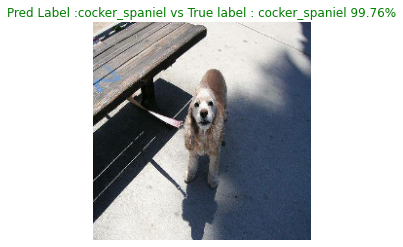

In [ ]:
plot_pred(labels = val_labels,
          images = val_images,
          prediction_probabilities = prediction,
          n = 110)

### Build a function to show the probability of each label's prediction
* Find the prediction probabilities indexes
* Find the probabilities values
* Prediction labels

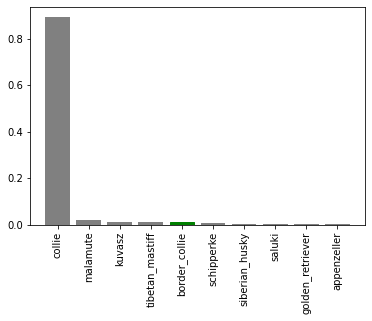

In [ ]:
# Return top 10 prediction value's location (position)
top_10_pred_index = prediction[9].argsort()[-10:][::-1]

# Return top 10 index probabilities.
top_10_pred_prob = prediction[9][top_10_pred_index]

# Return top 10 prediction indexes
top_10_pred_labels = unique_breeds[top_10_pred_index]

#Plotting Result
top_10 = plt.bar(np.arange(len(top_10_pred_labels)), 
                 top_10_pred_prob,
                 color = 'grey')
plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

if np.isin(predict_label(val_labels[9]) , top_10_pred_labels):
  top_10[np.argmax(top_10_pred_labels == predict_label(val_labels[9]))].set_color('green')
else:
  pass

In [ ]:
def plot_pred_conf(prediction_probabilities , labels ,n = 1):
  
  prediction_probabilities = prediction[n]
  true_label = labels[n]

  top_10_pred_index = prediction_probabilities.argsort()[-10:][::-1]
  top_10_pred_prob = prediction_probabilities[top_10_pred_index]
  top_10_pred_labels = unique_breeds[top_10_pred_index]

  top_10 = plt.bar(np.arange(len(top_10_pred_labels)), 
                   top_10_pred_prob,
                   color = 'grey')
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")
  
  if np.isin(predict_label(true_label) , top_10_pred_labels):
   top_10[np.argmax(top_10_pred_labels == predict_label(true_label))].set_color('green')
  else:
    pass


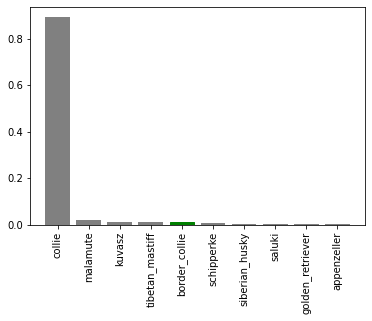

In [ ]:
plot_pred_conf(prediction_probabilities = prediction , 
               labels = val_labels,
               n = 9)

### Check image with predicted value graph

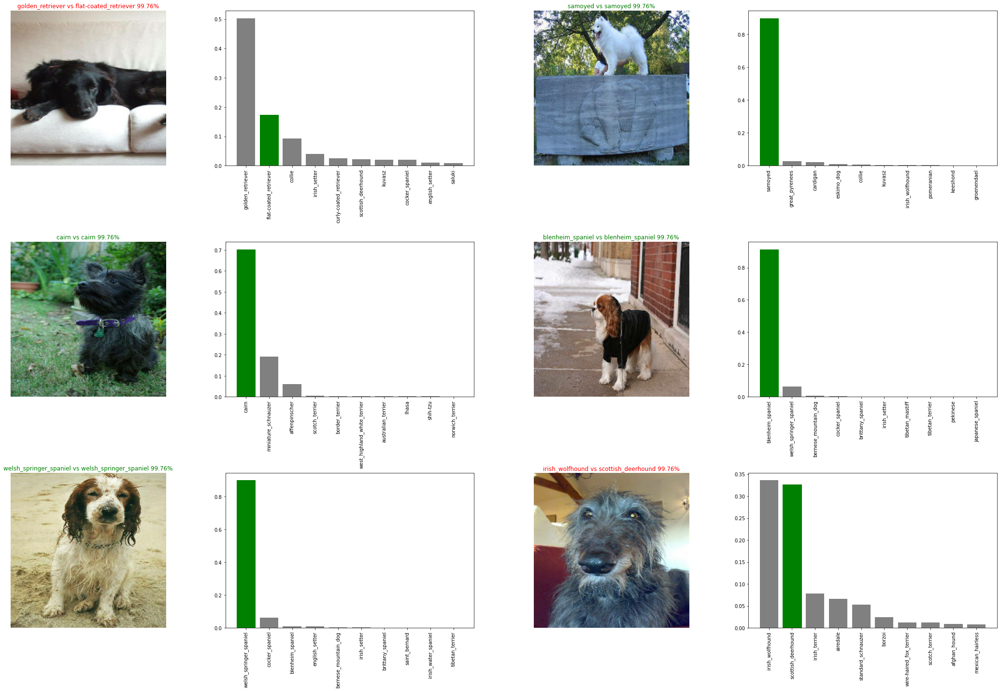

In [ ]:
i_multiplier = 20
num_rows = 3
num_cols = 2
num_images = num_rows * num_cols

plt.figure(figsize = (10*num_rows, 10*num_cols))

for i in range(num_images):
  plt.subplot(num_rows, num_cols*2 , 2*i+1)
  plot_pred(labels = val_labels,
            images = val_images,
            prediction_probabilities = prediction,
            n = i+i_multiplier)
  
  plt.subplot(num_rows, num_cols*2 , 2*i+2)
  plot_pred_conf(prediction_probabilities = prediction , 
                 labels = val_labels,
                 n = i+i_multiplier)
plt.tight_layout(h_pad = 1.0)
plt.show()

## **Saving and Reloading model**

In [ ]:
def save_model(model, suffix = None):
  modeldir = os.path.join('/content/drive/MyDrive/Colab_Notebooks/dog_vision/models',
                          datetime.datetime.now().strftime('%Y%m%d-%H%M%s'))
  model_path = modeldir + '-' + '.h5'
  print(f'Saving model to {model_path}...')
  model.save(model_path)
  return model_path


In [ ]:
def load_model(model_path):

  print(f'Loading model to {model_path}...')

  # Refer to custom layer : custom layer for custom objects. Non Standard Dense Layer
  model = tf.keras.models.load_model(model_path,
                                     custom_objects = {'KerasLayer':hub.KerasLayer} ) 
  return model

In [ ]:
save_model(model , suffix = '1000-images-mobilenetv2-Adam')

Saving model to /content/drive/MyDrive/Colab_Notebooks/dog_vision/models/20210525-10091621937348-.h5...


'/content/drive/MyDrive/Colab_Notebooks/dog_vision/models/20210525-10091621937348-.h5'

In [ ]:
loaded_1000_model = load_model('/content/drive/MyDrive/Colab_Notebooks/dog_vision/models/20210525-10091621937348-.h5')

Loading model to /content/drive/MyDrive/Colab_Notebooks/dog_vision/models/20210525-10091621937348-.h5...


In [ ]:
# Evaluating Pre-Saved Model
model.evaluate(val_data)

7/7 [==============================] - 1s 104ms/step - loss: 1.2613 - accuracy: 0.6750


[1.2613492012023926, 0.675000011920929]

In [ ]:
# Evaluating Current Model
loaded_1000_model.evaluate(val_data)

7/7 [==============================] - 1s 104ms/step - loss: 1.2613 - accuracy: 0.6750


[1.2613492012023926, 0.675000011920929]

## **Training a model (On Full Data)**
* Create Databatch
* Create Model
* Create callback tensorboard , early stopping
* Model.fit

In [ ]:
len(X) , len(y)

(10222, 10222)

In [ ]:
full_data = create_data_batches(X,y)

Creating Training data batches...


In [ ]:
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [ ]:
full_model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer_3 (KerasLayer)   (None, 1001)              5432713   
_________________________________________________________________
dense_3 (Dense)              (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


In [ ]:
full_model_tensorboard = create_tensorboard_callback()
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor = 'accuracy',
                                                            patience = 3)

In [ ]:
full_model.fit(x = full_data,
               epochs = NUM_EPOCHS,
               callbacks = [full_model_tensorboard , full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 1907s 6s/step - loss: 2.3946 - accuracy: 0.4878
Epoch 2/100
320/320 [==============================] - 39s 121ms/step - loss: 0.3988 - accuracy: 0.8878
Epoch 3/100
320/320 [==============================] - 39s 121ms/step - loss: 0.2265 - accuracy: 0.9410
Epoch 4/100
320/320 [==============================] - 39s 121ms/step - loss: 0.1429 - accuracy: 0.9677
Epoch 5/100
320/320 [==============================] - 38s 120ms/step - loss: 0.1012 - accuracy: 0.9807
Epoch 6/100
320/320 [==============================] - 38s 120ms/step - loss: 0.0739 - accuracy: 0.9876
Epoch 7/100
320/320 [==============================] - 38s 119ms/step - loss: 0.0564 - accuracy: 0.9917
Epoch 8/100
320/320 [==============================] - 38s 119ms/step - loss: 0.0416 - accuracy: 0.9962
Epoch 9/100
320/320 [==============================] - 38s 120ms/step - loss: 0.0356 - accuracy: 0.9967
Epoch 10/100
320/320 [==============================] - 38s 119ms

In [ ]:
save_model(full_model , suffix = 'full_dataset_mobilesetv2-Adam')

Saving model to /content/drive/MyDrive/Colab_Notebooks/dog_vision/models/20210525-11071621940878-.h5...


'/content/drive/MyDrive/Colab_Notebooks/dog_vision/models/20210525-11071621940878-.h5'

In [ ]:
loaded_full_model  = load_model('/content/drive/MyDrive/Colab_Notebooks/dog_vision/models/20210525-11071621940878-.h5')

Loading model to /content/drive/MyDrive/Colab_Notebooks/dog_vision/models/20210525-11071621940878-.h5...


## **Evaluating Test Result**

### Create image filepath test data images

In [ ]:
os.listdir('/content/drive/MyDrive/Colab_Notebooks/dog_vision/test_data')[1:10]

['e7ce78e874945f182a4f5149aa505b09.jpg',
 'e7afb35b8252782013a6700e28e327fa.jpg',
 'e7dc8cc599049ea9fa2a172c88646c57.jpg',
 'e7afcce6e45858fc3b294cc5c0b15a53.jpg',
 'e7be7b911a4cba9fdfa4105ec4776370.jpg',
 'e7b608110b0e29120d8740f37e85f3d0.jpg',
 'e7e9624f2a2e61ab187358f5968bfde8.jpg',
 'e7b357150635c250757363718e4dae86.jpg',
 'e7feb64da6aae1ef8e62453f6660d0c5.jpg']

In [ ]:
test_path = '/content/drive/MyDrive/Colab_Notebooks/dog_vision/test_data/'
test_filename = [test_path + fname for fname in os.listdir(test_path)]
test_filename[:5]

['/content/drive/MyDrive/Colab_Notebooks/dog_vision/test_data/e7ed96b272013c6de9505a753816ce75.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/test_data/e7ce78e874945f182a4f5149aa505b09.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/test_data/e7afb35b8252782013a6700e28e327fa.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/test_data/e7dc8cc599049ea9fa2a172c88646c57.jpg',
 '/content/drive/MyDrive/Colab_Notebooks/dog_vision/test_data/e7afcce6e45858fc3b294cc5c0b15a53.jpg']

In [ ]:
if len(test_filename) == len(os.listdir(test_path)):
  print('Equal Dataset')
else:
  pass

Equal Dataset


In [ ]:
test_data = create_data_batches(test_filename , test_data = True)

Creating test data batches.. 


In [ ]:
test_predictions = loaded_full_model.predict(test_data,
                                              verbose = 1)

324/324 [==============================] - 1921s 6s/step


In [ ]:
test_predictions.shape

(10357, 120)

## **Preparing test dataset for kaggle**

In [ ]:
list(unique_breeds)

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [ ]:
# preds_df = pd.DataFrame()
# preds_df['id'] = ['id']
# preds_df[list(unique_breeds)] = list(unique_breeds)
# preds_df.drop(index = 0 , axis = 0)

preds_df = pd.DataFrame(columns = ['id']+ list(unique_breeds))
preds_df

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [ ]:
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
test_ids[:10]
preds_df['id'] = test_ids
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e7ed96b272013c6de9505a753816ce75,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,e7ce78e874945f182a4f5149aa505b09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e7afb35b8252782013a6700e28e327fa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e7dc8cc599049ea9fa2a172c88646c57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e7afcce6e45858fc3b294cc5c0b15a53,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e7ed96b272013c6de9505a753816ce75,4.2088e-08,4.38387e-09,1.83801e-10,1.90707e-07,1.2887e-07,1.17429e-11,0.995794,2.11808e-07,5.09885e-09,3.98344e-09,3.30842e-09,9.59957e-09,1.4827e-08,1.19524e-09,1.60023e-09,1.39793e-09,1.47185e-09,1.6533e-08,1.04841e-11,1.0802e-09,1.95491e-11,6.27512e-10,3.50854e-08,3.04383e-08,6.19075e-11,7.26359e-10,1.90331e-07,6.30347e-09,1.51109e-09,1.66084e-06,2.7852e-07,5.29188e-10,1.58039e-11,1.60776e-08,8.30603e-12,4.14298e-08,7.79147e-09,1.32667e-10,7.14006e-09,...,5.25771e-10,0.00197712,9.8402e-12,8.19638e-09,5.63765e-06,1.68888e-08,6.43006e-07,6.99748e-07,1.26929e-11,1.60649e-08,1.74616e-11,7.62332e-11,1.62427e-11,2.51952e-11,3.23505e-09,1.66927e-07,1.02287e-09,1.6109e-08,1.3898e-10,4.31349e-10,1.00956e-08,3.1812e-10,0.000242032,2.41385e-11,2.39231e-08,2.43098e-08,2.37308e-09,1.28315e-06,9.93405e-10,4.4591e-07,8.02869e-08,1.20829e-06,8.45205e-08,1.01141e-08,6.98323e-10,1.75364e-08,8.7872e-08,1.25631e-09,5.84489e-07,0.000746125
1,e7ce78e874945f182a4f5149aa505b09,1.51261e-07,6.32395e-11,1.01391e-05,1.22417e-13,2.17342e-09,7.01994e-08,9.1944e-09,5.86325e-08,7.34769e-12,4.15479e-12,2.06013e-10,9.999e-09,1.57271e-09,1.00932e-11,1.23802e-08,1.03108e-09,8.64751e-07,1.13526e-09,8.55533e-11,5.19741e-07,2.32911e-09,4.6995e-13,6.63058e-07,4.29721e-09,2.28368e-08,6.61982e-12,8.58972e-10,9.97859e-07,8.99984e-09,3.4392e-06,1.67974e-08,3.08603e-08,2.85608e-10,9.0117e-08,1.97786e-06,3.71086e-09,3.65004e-07,1.57632e-06,2.78976e-09,...,4.60816e-06,8.42178e-07,3.4387e-12,1.07991e-10,5.11137e-06,3.09595e-10,1.12947e-07,1.34524e-06,1.05253e-08,3.23138e-08,5.73578e-12,3.08309e-10,3.45477e-11,8.76476e-11,3.02183e-09,0.794976,2.37965e-06,4.76618e-08,9.01945e-10,5.37508e-09,3.40646e-09,1.08288e-06,6.847e-11,1.78778e-09,8.57154e-07,6.31512e-08,1.57595e-10,4.99956e-07,1.10006e-07,8.02845e-09,3.09102e-07,8.88532e-09,2.92795e-09,3.58422e-11,5.36185e-09,7.52809e-11,4.98854e-09,2.14217e-09,3.97449e-09,9.84121e-07
2,e7afb35b8252782013a6700e28e327fa,2.03981e-11,2.47501e-10,1.45243e-11,8.02857e-10,1.42514e-10,1.29908e-08,9.12706e-12,8.57051e-12,5.47575e-10,5.25302e-14,0.999828,1.12983e-10,2.39212e-10,3.94064e-11,3.6029e-12,9.75415e-09,1.69184e-11,6.53082e-11,1.83266e-10,1.2698e-10,1.06826e-12,7.90798e-11,2.45082e-11,2.42703e-10,1.00728e-09,3.55182e-12,9.31776e-11,3.19033e-12,2.12214e-09,5.12891e-10,3.65592e-12,7.83839e-09,6.02623e-13,1.40768e-10,1.8372e-07,7.13714e-09,5.3589e-12,2.35947e-11,8.07878e-11,...,2.54541e-10,7.99466e-14,7.30655e-08,5.93524e-10,4.49483e-09,7.9641e-13,8.00909e-14,6.24042e-13,7.57033e-11,7.07785e-10,6.95562e-10,4.58306e-13,8.52573e-12,8.93327e-11,4.46232e-10,5.27953e-11,8.53551e-11,2.37138e-06,8.22188e-07,8.31764e-13,2.08326e-09,5.14148e-09,5.86295e-09,2.94749e-09,4.75837e-09,1.90355e-06,4.6707e-09,5.80971e-12,1.44796e-11,1.65415e-10,1.936e-09,4.76836e-08,2.39244e-09,9.91033e-10,1.36267e-08,2.88738e-10,3.84855e-08,1.085

In [ ]:
preds_df.to_csv('/content/drive/MyDrive/Colab_Notebooks/dog_vision/full_model_prediction_kagglesub_mobilenetV2.csv',
                index = False)